# Capstone Project - The Battle of the Neighborhoods
### Applied Data Science Capstone by IBM/Coursera

## Table of contents
* [Introduction: Business Problem](#introduction)
* [Data](#data)
* [Methodology](#methodology)
* [Analysis](#analysis)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)

## Introduction: Business Problem <a name="introduction"></a>

Bangalore is the capital and largest city of the Indian state of Karnataka. It is famous for traffic 24/7. With a population of over 15 million (as of January 2016), Bangalore is the third largest city in India and 27th largest city in the world.The diversity of the cuisine available is reflective of the social and economic diversity of Bangalore. Roadside vendors, tea stalls, South Indian, North Indian, Arabic food, Chinese and Western fast food are all very popular in the city.
So as part of this project ,we will list and visualize all major parts of Bangalore City.
This analysis will be useful for foodies who are living or newly shifting to Bangalore and will be able to decide the locality they can explore basis their food preferences. The insights obtained from this analysis will also be relevant to existing restaurant owners and to the people planning to open one.

Questions that can be asked using the above mentioned datasets:

a.	How popular is online ordering in Bangalore? Is there a relationship between ratings and online ordering option in restaurants?

b.	How many restaurants have option to book a table online ? Is there a relationship between ratings and online booking table option in restaurants?

c.	Which restaurants have maximum number of venues across the city?

d.	Top 10 costliest restaurants in city.

e.	Top 10 cheapest restaurants in city.

f.	Which location in Bangalore has the highest rated restaurants?

g.	Which type of restaurants are most popular in Bangalore?

h.	Maximum restaurants of which type are present in each location.

i.	Which location in city has maximum and minimum number of restaurants across the city?

j.	Which locations in Bangalore are similar in terms of nearby venues?

## Data <a name="data"></a>

For this project we used the following data :

A.	Bangalore Restaurants data that contains list Neighbourhood, Restaurant name, Rating along with their latitude and longitude.

Data source : Kaggle Dataset

Description : This data set contains the required information. And we will use this data set to explore various locality of Bangalore city.

B.	Nearby places in each locality of Bangalore city.

Data source : Fousquare API

Description : By using this api, we will get all the venues in each neighbourhood.

C.	 Neighbourhood coordinates of each locality of Bangalore city.

Data source: Geocoder python


In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

usage: conda-script.py [-h] [-V] command ...
conda-script.py: error: unrecognized arguments: # uncomment this line if you haven't completed the Foursquare API lab
usage: conda-script.py [-h] [-V] command ...
conda-script.py: error: unrecognized arguments: # uncomment this line if you haven't completed the Foursquare API lab


## Define Foursquare credentials

In [223]:
CLIENT_ID = '' # your Foursquare ID
CLIENT_SECRET = '' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: 
CLIENT_SECRET:


## Import dataset zomato Bangalore

In [3]:
import pandas as pd
df=pd.read_csv(r'C:\Users\mahesh\Desktop\Python\Coursera\Capstone\Capstone-Project-Samriti -IBM\zomato.csv')

## Get unique values for each column

In [4]:
len(df['location'].unique())

94

In [5]:
df['rest_type'].unique()

array(['Casual Dining', 'Cafe, Casual Dining', 'Quick Bites',
       'Casual Dining, Cafe', 'Cafe', 'Quick Bites, Cafe',
       'Cafe, Quick Bites', 'Delivery', 'Mess', 'Dessert Parlor',
       'Bakery, Dessert Parlor', 'Pub', 'Bakery', 'Takeaway, Delivery',
       'Fine Dining', 'Beverage Shop', 'Sweet Shop', 'Bar',
       'Beverage Shop, Quick Bites', 'Confectionery',
       'Quick Bites, Beverage Shop', 'Dessert Parlor, Sweet Shop',
       'Bakery, Quick Bites', 'Sweet Shop, Quick Bites', 'Kiosk',
       'Food Truck', 'Quick Bites, Dessert Parlor',
       'Beverage Shop, Dessert Parlor', 'Takeaway', 'Pub, Casual Dining',
       'Casual Dining, Bar', 'Dessert Parlor, Beverage Shop',
       'Quick Bites, Bakery', 'Dessert Parlor, Quick Bites',
       'Microbrewery, Casual Dining', 'Lounge', 'Bar, Casual Dining',
       'Food Court', 'Cafe, Bakery', nan, 'Dhaba',
       'Quick Bites, Sweet Shop', 'Microbrewery',
       'Food Court, Quick Bites', 'Pub, Bar', 'Casual Dining, Pub',
      

In [6]:
df['listed_in(type)'].unique()

array(['Buffet', 'Cafes', 'Delivery', 'Desserts', 'Dine-out',
       'Drinks & nightlife', 'Pubs and bars'], dtype=object)

In [7]:
df['listed_in(city)'].unique()

array(['Banashankari', 'Bannerghatta Road', 'Basavanagudi', 'Bellandur',
       'Brigade Road', 'Brookefield', 'BTM', 'Church Street',
       'Electronic City', 'Frazer Town', 'HSR', 'Indiranagar',
       'Jayanagar', 'JP Nagar', 'Kalyan Nagar', 'Kammanahalli',
       'Koramangala 4th Block', 'Koramangala 5th Block',
       'Koramangala 6th Block', 'Koramangala 7th Block', 'Lavelle Road',
       'Malleshwaram', 'Marathahalli', 'MG Road', 'New BEL Road',
       'Old Airport Road', 'Rajajinagar', 'Residency Road',
       'Sarjapur Road', 'Whitefield'], dtype=object)

## Dropping the NA rows from the datframe

In [8]:
df=df.dropna(how='all')

In [9]:
k=len(df)
print("Length of actual dataframe is "+ str(k))

Length of actual dataframe is 51717


#### Use geopy library to get the latitude and longitude values of Bangalore City locations using Nominatim library

In [10]:
str_locations=df['listed_in(city)'].unique().tolist()

In [11]:
df_location=pd.DataFrame(str_locations)

In [12]:
df_latitude=[]
df_longitude=[]
for i in range(0,len(str_locations)):
    address = 'Bangalore,' + str_locations[i]

    geolocator = Nominatim(user_agent="ny_explorer")
    location = geolocator.geocode(address)
    latitude = location.latitude
    df_latitude.append(latitude)
    longitude = location.longitude
    df_longitude.append(longitude)
    print('The geograpical coordinate of Bangalore City in {}, are {}, {}.'.format(str_locations[i],latitude, longitude))

The geograpical coordinate of Bangalore City in Banashankari, are 12.9152208, 77.573598.
The geograpical coordinate of Bangalore City in Bannerghatta Road, are 12.9358025, 77.6013919.
The geograpical coordinate of Bangalore City in Basavanagudi, are 12.9417261, 77.5755021.
The geograpical coordinate of Bangalore City in Bellandur, are 12.9791198, 77.5912997.
The geograpical coordinate of Bangalore City in Brigade Road, are 12.9736132, 77.6074716.
The geograpical coordinate of Bangalore City in Brookefield, are 12.9668213, 77.7168891.
The geograpical coordinate of Bangalore City in BTM, are 12.911275849999999, 77.60456543431182.
The geograpical coordinate of Bangalore City in Church Street, are 12.9742939, 77.6525189.
The geograpical coordinate of Bangalore City in Electronic City, are 12.9791198, 77.5912997.
The geograpical coordinate of Bangalore City in Frazer Town, are 12.996845, 77.6130165.
The geograpical coordinate of Bangalore City in HSR, are 12.9116225, 77.6388622.
The geograp

In [13]:
## Combine all these lists into dataframes 
df_coordinates = pd.DataFrame(
    {'location': str_locations,
     'latitude': df_latitude,
     'longitude': df_longitude
    })

In [14]:
df_coordinates

,location,latitude,longitude
0,Banashankari,12.915221,77.573598
1,Bannerghatta Road,12.935802,77.601392
2,Basavanagudi,12.941726,77.575502
3,Bellandur,12.979120,77.591300
4,Brigade Road,12.973613,77.607472
5,Brookefield,12.966821,77.716889
6,BTM,12.911276,77.604565
7,Church Street,12.974294,77.652519
8,Electronic City,12.979120,77.591300
9,Frazer Town,12.996845,77.613017


In [15]:
df_req=df

In [16]:
## Get the relevant columns
df_req2=df_req[['name','online_order','book_table','rate','location','cuisines','approx_cost(for two people)','listed_in(type)','listed_in(city)','rest_type']]

## Merge the dataframe with the coordinates

In [17]:
final_df=df_req2.merge(df_coordinates,left_on='location',right_on='location')

In [18]:
final_df['online_order'].unique()

array(['Yes', 'No'], dtype=object)

In [19]:
final_df.drop_duplicates(inplace=True)

In [20]:
len(final_df)

39687

### Make relevant data manipulations to get the relevant features

In [21]:
final_df_two=final_df

In [22]:
final_df_two=final_df_two.drop(columns='listed_in(type)')

In [23]:
final_df_two=final_df_two.drop(columns='cuisines')

In [24]:
final_df_two.drop_duplicates(inplace=True)

In [25]:
final_df_three=final_df_two

In [26]:
final_df_three=final_df_three.drop(columns='rate')

In [27]:
final_df_three.drop_duplicates(inplace=True)

In [28]:
final_df_two[final_df_two['name']=='Jalsa']

,name,online_order,book_table,rate,location,approx_cost(for two people),listed_in(city),rest_type,latitude,longitude
0,Jalsa,Yes,Yes,4.1/5,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
487,Jalsa,Yes,Yes,4.1/5,Banashankari,800,Basavanagudi,Casual Dining,12.915221,77.573598
651,Jalsa,Yes,Yes,4.1 /5,Banashankari,800,Basavanagudi,Casual Dining,12.915221,77.573598
770,Jalsa,Yes,Yes,4.1/5,Banashankari,800,Jayanagar,Casual Dining,12.915221,77.573598
847,Jalsa,Yes,Yes,4.1 /5,Banashankari,800,Jayanagar,Casual Dining,12.915221,77.573598
16711,Jalsa,Yes,Yes,4.2/5,Marathahalli,"1,500",Brookefield,Casual Dining,12.955257,77.698416
17477,Jalsa,Yes,Yes,4.2 /5,Marathahalli,"1,500",Marathahalli,Casual Dining,12.955257,77.698416


In [29]:
final_df_three.head()

,name,online_order,book_table,location,approx_cost(for two people),listed_in(city),rest_type,latitude,longitude
0,Jalsa,Yes,Yes,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
1,Spice Elephant,Yes,No,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
2,San Churro Cafe,Yes,No,Banashankari,800,Banashankari,"Cafe, Casual Dining",12.915221,77.573598
3,Addhuri Udupi Bhojana,No,No,Banashankari,300,Banashankari,Quick Bites,12.915221,77.573598
4,Onesta,Yes,Yes,Banashankari,600,Banashankari,"Casual Dining, Cafe",12.915221,77.573598


## Methodology <a name="methodology"></a>

In this project we will direct our efforts on analyzing different areas of Bangalore and getting answers to the questions like which places are best for foodies to live in, how much is the popularity of online ordering option in Bangalore, how are the ratings and customer experience through table bookings on Zomato linked, which restaurants are cheapest, costliest etc.

In first step we have collected the required data: Bangalore restaurants data source Zomato from **Kaggle dataset** . Location and type (category) of venues around each location in Bangalore through **Foursquare API**.
Coordinates for each location from **Geocoder Python**.

Second step in our analysis will be exploration of restaurants in different areas of Bangalore.We will use different visualizations to get insights on the best places for foodies, various options to choose basis the budget and popularity of online ordering option and bookings option and how they are related to better user experience.

In third and final step we will focus on different areas and within those create clusters of locations that have similar type of neighbouring venues.We will present map of all such locations and create clusters (using **k-means clustering**) of those locations to identify similar neighborhoods and generate insights.

## Analysis <a name="analysis"></a>

### Calculation of Total restaurants in Bangalore in our dataset

In [30]:
total_res=len(final_df_three['name'].unique())
print(total_res)

6884


### Number of restaurants in Bangalore with Online ordering option

In [31]:
## Visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams

In [32]:
online_df=final_df_three

In [33]:
online_df=online_df[['name','online_order','book_table','listed_in(city)']]

In [34]:
online_df.drop_duplicates(inplace=True)

C:\Users\mahesh\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [35]:
online_df_req=online_df[['name','online_order']]

In [36]:
online_df_req.drop_duplicates(inplace=True)

C:\Users\mahesh\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [37]:
online_df.head()

,name,online_order,book_table,listed_in(city)
0,Jalsa,Yes,Yes,Banashankari
1,Spice Elephant,Yes,No,Banashankari
2,San Churro Cafe,Yes,No,Banashankari
3,Addhuri Udupi Bhojana,No,No,Banashankari
4,Onesta,Yes,Yes,Banashankari


In [38]:
online_df_req=online_df.groupby('name')['online_order'].sum().reset_index()

In [39]:
online_df_req.head()

,name,online_order
0,#FeelTheROLL,NoNo
1,#L-81 Cafe,YesYesYesYesYesYes
2,#Vibes Restro,No
3,#refuel,Yes
4,1 Fahreheit,No


In [40]:
online_df_req['online_order'][1]

'YesYesYesYesYesYes'

In [41]:
online_df_req["online_order"]=online_df_req["online_order"].apply(lambda x: 'No' if (x.find("Yes")) else ('Yes'))

In [42]:
online_res=len(online_df_req[online_df_req['online_order']=='Yes'])

In [43]:
len(online_df_req[online_df_req['online_order']=='No'])

3581

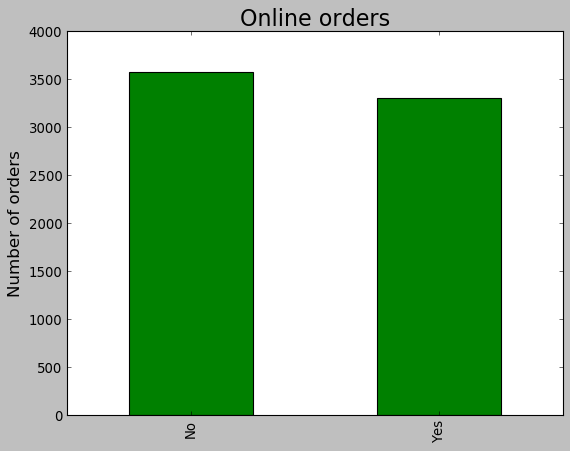

In [44]:
plt.rcParams['figure.figsize'] = (3, 4)
plt.style.use('_classic_test')
online_df_req['online_order'].value_counts().plot.bar(color = 'green')
plt.title('Online orders', fontsize = 20)
plt.ylabel('Number of orders', fontsize = 15)
plt.show()

### Insight: 48% restaurants in Bangalore have online ordering option

### Percentage of restaurants with Online option

In [45]:
(online_res/total_res)*100

47.98082510168506

In [63]:
online_df2=final_df_two[['name','online_order','book_table','rate','listed_in(city)']]

In [64]:
online_df2.drop_duplicates(inplace=True)

C:\Users\mahesh\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [65]:
online_df2=online_df2.dropna()

In [66]:
online_df2 = online_df2[online_df2.rate != 'NEW']

In [67]:
online_df2['rate']

0         4.1/5
1         4.1/5
2         3.8/5
3         3.7/5
4         4.6/5
5         4.0/5
6         4.2/5
7         4.1/5
8         4.2/5
9         4.2/5
10        4.0/5
12        3.8/5
13        3.9/5
14        3.8/5
15        3.9/5
16        3.1/5
17        3.0/5
18        3.7/5
19        3.6/5
20        3.6/5
21        3.7/5
22        3.2/5
23        3.8/5
24        3.3/5
25        3.3/5
26        2.8/5
27        3.9/5
28        3.9/5
29        4.2/5
30        3.9/5
31        2.8/5
32        4.2/5
33        4.0/5
34        3.9/5
35        3.9/5
36        3.9/5
38        3.8/5
39        3.7/5
40        4.3/5
41        4.0/5
42        3.9/5
43        3.8/5
44        4.2/5
45        3.6/5
46        3.7/5
47        4.2/5
48        4.0/5
49        3.7/5
50        4.1/5
51        3.8/5
52        3.6/5
53        4.1/5
55        2.9/5
56        3.6/5
58        3.6/5
59        3.7/5
60        3.8/5
61        4.2/5
62        3.5/5
63        3.8/5
65        4.0/5
66        3.5/5
67      

In [68]:
online_df2['rate'] = online_df2['rate'].map(lambda x: x.rstrip('/5'))

In [71]:
online_df2 = online_df2[online_df2.rate != '-']

In [72]:
online_df2['rate'] = online_df2['rate'].astype(float)

In [73]:
online_df2=online_df2.groupby('name')['rate'].mean().reset_index()

## Data frame has less rows as some of restaurants are New or do not have ratings

In [74]:
len(online_df2)

5248

In [75]:
online_df2.head()

,name,rate
0,#FeelTheROLL,3.4
1,#L-81 Cafe,3.9
2,#refuel,3.7
3,1000 B.C,3.2
4,100ÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ°C,3.7


In [76]:
### Merge both the dataframes

In [89]:
online_df_req=online_df_req.merge(online_df2,left_on='name',right_on='name')

In [90]:
online_df_req.head()

,name,online_order_x,online_order_y,book_table,rate_x,listed_in(city),rate_y,rate_x,rate_y,rate
0,#FeelTheROLL,No,No,No,3.4/5,Bellandur,3.4,3.4,3.4,3.4
1,#FeelTheROLL,No,No,No,3.4 /5,Sarjapur Road,3.4,3.4,3.4,3.4
2,#L-81 Cafe,Yes,Yes,No,3.9/5,BTM,3.9,3.9,3.9,3.9
3,#L-81 Cafe,Yes,Yes,No,3.9/5,HSR,3.9,3.9,3.9,3.9
4,#L-81 Cafe,Yes,Yes,No,3.9/5,Koramangala 4th Block,3.9,3.9,3.9,3.9


In [96]:
online_df_req = online_df_req.drop(columns=['online_order_y', 'rate_x','rate_y'])
online_df_req.head()

,name,online_order_x,book_table,listed_in(city),rate
0,#FeelTheROLL,No,No,Bellandur,3.4
1,#FeelTheROLL,No,No,Sarjapur Road,3.4
2,#L-81 Cafe,Yes,No,BTM,3.9
3,#L-81 Cafe,Yes,No,HSR,3.9
4,#L-81 Cafe,Yes,No,Koramangala 4th Block,3.9


In [98]:
column_new = ['name', 'online_order', 'book_table', 'listed_in(city)', 'rate']
online_df_req.columns = column_new

In [99]:
online_df_req.head()

,name,online_order,book_table,listed_in(city),rate
0,#FeelTheROLL,No,No,Bellandur,3.4
1,#FeelTheROLL,No,No,Sarjapur Road,3.4
2,#L-81 Cafe,Yes,No,BTM,3.9
3,#L-81 Cafe,Yes,No,HSR,3.9
4,#L-81 Cafe,Yes,No,Koramangala 4th Block,3.9


In [100]:
online_df_req['rate'].unique()

array([3.4       , 3.9       , 3.7       , 3.2       , 3.7       ,
       3.        , 4.5       , 4.1       , 4.2125    , 4.1       ,
       3.16666667, 4.04285714, 3.1       , 4.        , 3.6       ,
       3.3       , 2.95      , 3.7       , 4.2       , 3.66      ,
       4.42      , 3.2       , 3.65      , 3.9       , 3.8       ,
       3.74      , 4.2       , 3.8       , 4.05      , 2.7       ,
       2.8       , 3.3       , 4.35555556, 3.30689655, 2.775     ,
       4.8       , 3.25      , 3.32857143, 4.4       , 4.45      ,
       3.3       , 3.5       , 3.28571429, 3.51428571, 3.4       ,
       3.38333333, 3.88571429, 3.76666667, 3.23333333, 3.23333333,
       3.48      , 3.55625   , 2.9       , 3.68571429, 3.525     ,
       4.02      , 3.55      , 3.93333333, 3.05      , 3.26666667,
       3.3125    , 3.82857143, 3.35      , 3.8625    , 4.425     ,
       4.3       , 3.47142857, 1.8       , 3.6       , 3.65      ,
       3.825     , 4.13333333, 3.86666667, 3.03333333, 3.375  

In [101]:
online_df_req["rate"]=online_df_req["rate"].apply(lambda x: round(x,1))

C:\Users\mahesh\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [102]:
online_df_req.head()

,name,online_order,book_table,listed_in(city),rate
0,#FeelTheROLL,No,No,Bellandur,3.4
1,#FeelTheROLL,No,No,Sarjapur Road,3.4
2,#L-81 Cafe,Yes,No,BTM,3.9
3,#L-81 Cafe,Yes,No,HSR,3.9
4,#L-81 Cafe,Yes,No,Koramangala 4th Block,3.9


### Relationship between online ordering and ratings

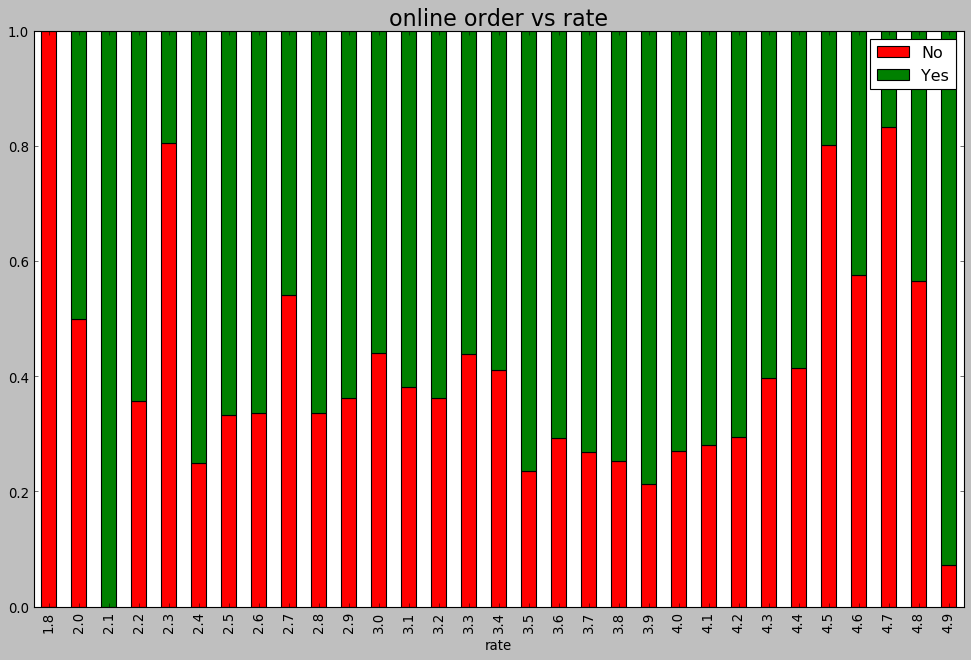

In [104]:
plt.rcParams['figure.figsize'] = (15, 9)
x = pd.crosstab(online_df_req['rate'], online_df_req['online_order'])
x.div(x.sum(1).astype(float), axis = 0).plot(kind = 'bar', stacked = True,color=['red','green'])
plt.title('online order vs rate', fontweight = 30, fontsize = 20)
plt.legend(loc="upper right")
plt.show()

### Findings
1. Less than 40% fo the resturatnts having rating in the range 3 to 4 do not accept online orders

### Number of restaurants in Bangalore with Booking table option available on Zomato

In [105]:
book_res=len(final_df_three[final_df_three['book_table']=='Yes']['name'].unique())
print(book_res)

688


In [106]:
final_df_three.head()

,name,online_order,book_table,location,approx_cost(for two people),listed_in(city),rest_type,latitude,longitude
0,Jalsa,Yes,Yes,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
1,Spice Elephant,Yes,No,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
2,San Churro Cafe,Yes,No,Banashankari,800,Banashankari,"Cafe, Casual Dining",12.915221,77.573598
3,Addhuri Udupi Bhojana,No,No,Banashankari,300,Banashankari,Quick Bites,12.915221,77.573598
4,Onesta,Yes,Yes,Banashankari,600,Banashankari,"Casual Dining, Cafe",12.915221,77.573598


In [107]:
booking_df=final_df_three[['name','book_table']]
booking_df.head()

,name,book_table
0,Jalsa,Yes
1,Spice Elephant,No
2,San Churro Cafe,No
3,Addhuri Udupi Bhojana,No
4,Onesta,Yes


In [108]:
booking_df.drop_duplicates(inplace=True)

C:\Users\mahesh\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [109]:
booking_df=booking_df.groupby('name')['book_table'].sum().reset_index()
booking_df.head()

,name,book_table
0,#FeelTheROLL,No
1,#L-81 Cafe,No
2,#Vibes Restro,No
3,#refuel,No
4,1 Fahreheit,No


In [110]:
booking_df["book_table"]=booking_df["book_table"].apply(lambda x: 'No' if (x.find("Yes")) else ('Yes'))

In [111]:
len(booking_df)

6884

In [112]:
book_yes=len(booking_df[booking_df['book_table']=='Yes'])
print(book_yes)

639


### Insight: 9.2% restaurants in Bangalore have booking option available on Zomato

### Percentage of restaurants with Booking option

In [113]:
(book_yes/total_res)*100

9.282393957001743

### Relationship between booking table online and ratings

In [ ]:
## merge both data frames

In [114]:
booking_df_req=booking_df.merge(online_df2,left_on='name',right_on='name')

In [115]:
booking_df_req["rate"]=booking_df_req["rate"].apply(lambda x: round(x,1))

In [116]:
booking_df_req.head()

,name,book_table,rate
0,#FeelTheROLL,No,3.4
1,#L-81 Cafe,No,3.9
2,#refuel,No,3.7
3,1000 B.C,No,3.2
4,100ÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ°C,No,3.7


### Insights: Higher rated restaurants have booking option availabe which is one of reason for that rating because of better customer experience

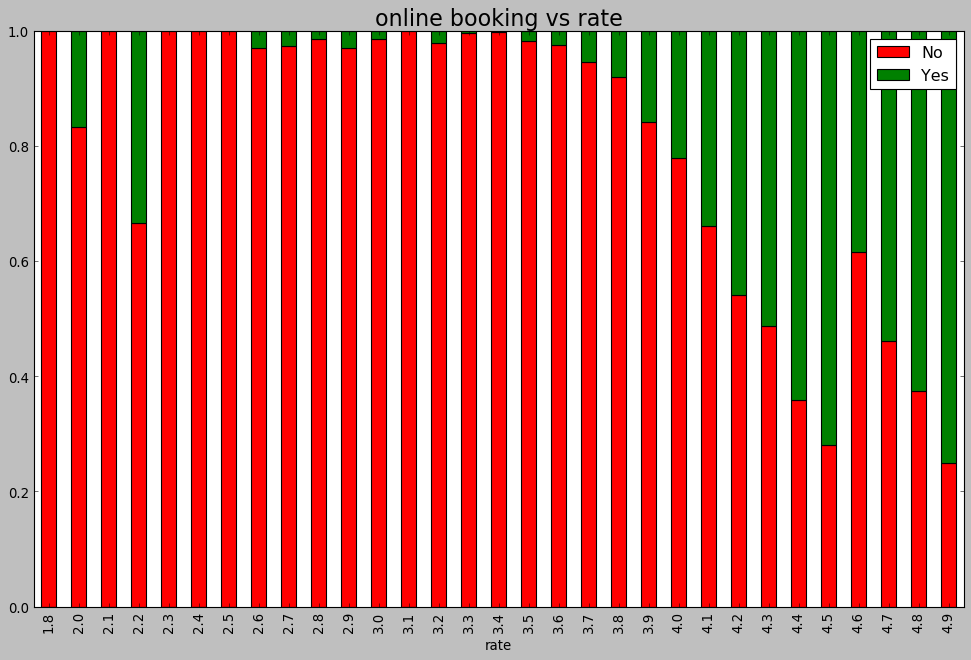

In [118]:
plt.rcParams['figure.figsize'] = (15, 9)
x = pd.crosstab(booking_df_req['rate'], booking_df_req['book_table'])
x.div(x.sum(1).astype(float), axis = 0).plot(kind = 'bar', stacked = True,color=['red','green'])
plt.title('online booking vs rate', fontweight = 30, fontsize = 20)
plt.legend(loc="upper right")
plt.show()

### Maximum venues in Banaglore are of Cafe Coffee Day

In [119]:
final_df_three.head()

,name,online_order,book_table,location,approx_cost(for two people),listed_in(city),rest_type,latitude,longitude
0,Jalsa,Yes,Yes,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
1,Spice Elephant,Yes,No,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
2,San Churro Cafe,Yes,No,Banashankari,800,Banashankari,"Cafe, Casual Dining",12.915221,77.573598
3,Addhuri Udupi Bhojana,No,No,Banashankari,300,Banashankari,Quick Bites,12.915221,77.573598
4,Onesta,Yes,Yes,Banashankari,600,Banashankari,"Casual Dining, Cafe",12.915221,77.573598


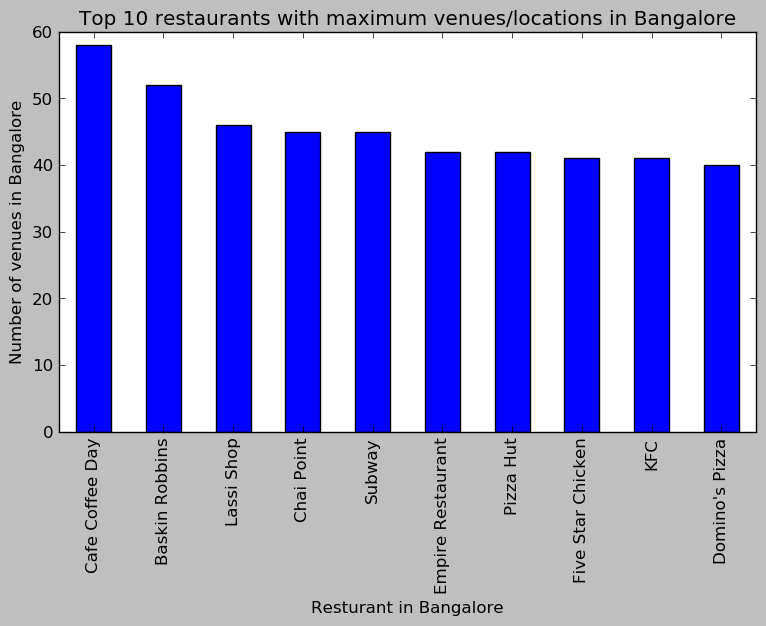

In [120]:
import matplotlib.pyplot as plt
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Top 10 restaurants with maximum venues/locations in Bangalore')
#On x-axis
final_df_three.groupby('name')['location'].count().nlargest(10).plot(kind='bar')
plt.xlabel('Resturant in Bangalore')
#On y-axis
plt.ylabel('Number of venues in Bangalore')
#displays the plot
plt.show()

### Restaurants costliest in Bangalore

In [121]:
type(final_df_three['approx_cost(for two people)'][0])

str

In [122]:
final_df_three['approx_cost(for two people)']=final_df_three['approx_cost(for two people)'].apply(lambda x:str(x))


In [123]:
final_df_three['approx_cost(for two people)']=final_df_three['approx_cost(for two people)'].apply(lambda x:x.replace(',',''))


In [124]:
final_df_three['approx_cost(for two people)'].unique()

array(['800', '300', '600', '700', '550', '500', '450', '650', '400',
       '900', '200', '750', '150', '850', '1200', '350', '100', '250',
       '950', '1000', '1300', '80', '1100', '160', '2200', '1500', '1350',
       '1700', 'nan', '1600', '1400', '180', '50', '190', '230', '130',
       '120', '70', '3000', '2000', '1800', '60', '2500', '560', '1250',
       '2700', '4500', '1900', '2100', '330', '2400', '1450', '3500',
       '40', '4000', '6000', '240', '2800', '3400', '2600', '2300',
       '1650'], dtype=object)

In [125]:
final_df_three_cost=final_df_three[final_df_three['approx_cost(for two people)']!='nan']

In [126]:
final_df_three_cost['approx_cost(for two people)']=final_df_three_cost['approx_cost(for two people)'].apply(lambda x:int(x))


C:\Users\mahesh\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [127]:
df_costliestvenues=final_df_three_cost.groupby('name')['approx_cost(for two people)'].mean().reset_index()

In [128]:
df_costliestvenues[df_costliestvenues['approx_cost(for two people)']==df_costliestvenues['approx_cost(for two people)'].max()]

,name,approx_cost(for two people)
3436,Le Cirque Signature - The Leela Palace,6000.0


In [129]:
df_costliestvenues=df_costliestvenues.set_index('name')

### The Leela Palace is the costliest Restaurant in Bangalore

In [130]:
final_df_three['approx_cost(for two people)'].head()

0    800
1    800
2    800
3    300
4    600
Name: approx_cost(for two people), dtype: object

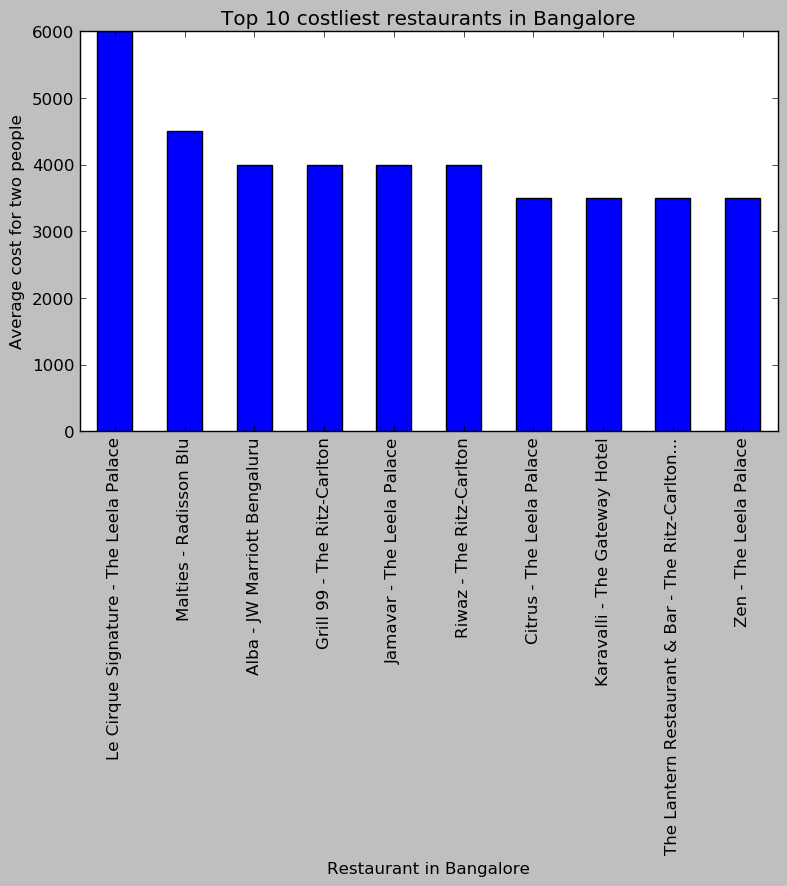

In [131]:
import matplotlib.pyplot as plt
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Top 10 costliest restaurants in Bangalore')
#On x-axis
#final_df_three.groupby('name')['approx_cost(for two people)'].mean().nlargest(10).plot(kind='bar')
df_costliestvenues['approx_cost(for two people)'].nlargest(10).plot(kind='bar')
plt.xlabel('Restaurant in Bangalore')
#On y-axis
plt.ylabel('Average cost for two people')
#displays the plot
plt.show()

### Cheapest resturants in Bangalore 

### Cheapest is bread and better

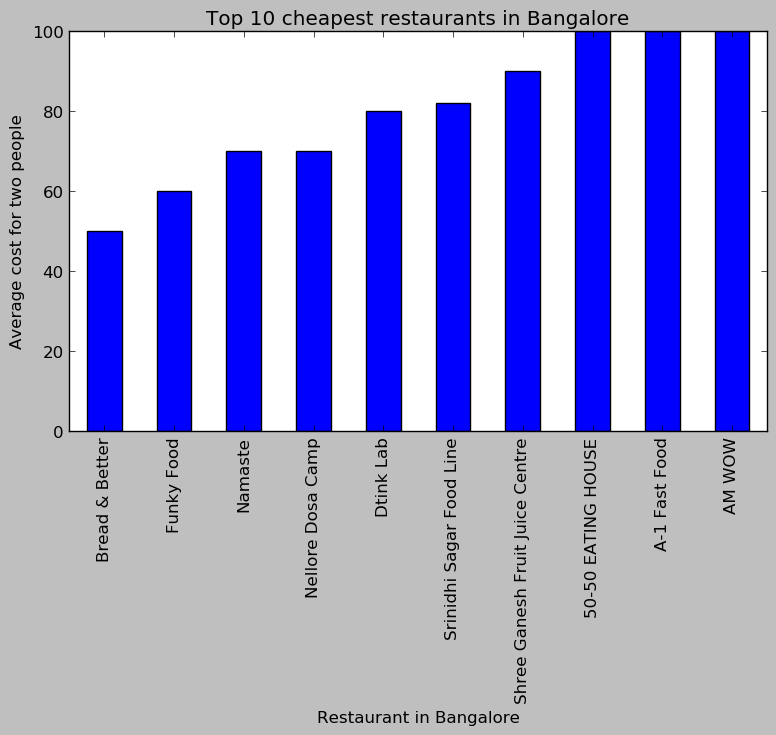

In [132]:
import matplotlib.pyplot as plt
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Top 10 cheapest restaurants in Bangalore')
#On x-axis
#final_df_three.groupby('name')['approx_cost(for two people)'].mean().nlargest(10).plot(kind='bar')
df_costliestvenues['approx_cost(for two people)'].nsmallest(10).plot(kind='bar')
plt.xlabel('Restaurant in Bangalore')
#On y-axis
plt.ylabel('Average cost for two people')
#displays the plot
plt.show()

### Rating comparisons

In [133]:
final_df_two[final_df_two['name']=='Jalsa']

,name,online_order,book_table,rate,location,approx_cost(for two people),listed_in(city),rest_type,latitude,longitude
0,Jalsa,Yes,Yes,4.1/5,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
487,Jalsa,Yes,Yes,4.1/5,Banashankari,800,Basavanagudi,Casual Dining,12.915221,77.573598
651,Jalsa,Yes,Yes,4.1 /5,Banashankari,800,Basavanagudi,Casual Dining,12.915221,77.573598
770,Jalsa,Yes,Yes,4.1/5,Banashankari,800,Jayanagar,Casual Dining,12.915221,77.573598
847,Jalsa,Yes,Yes,4.1 /5,Banashankari,800,Jayanagar,Casual Dining,12.915221,77.573598
16711,Jalsa,Yes,Yes,4.2/5,Marathahalli,"1,500",Brookefield,Casual Dining,12.955257,77.698416
17477,Jalsa,Yes,Yes,4.2 /5,Marathahalli,"1,500",Marathahalli,Casual Dining,12.955257,77.698416


In [134]:
final_df_two['rate']=final_df_two['rate'].apply(lambda x:str(x))
final_df_two['rate']=final_df_two['rate'].apply(lambda x:x[0:-2])
final_df_two['rate']=final_df_two['rate'].apply(lambda x:x.replace(' ',''))

In [135]:
final_df_two.drop_duplicates(inplace=True)

In [136]:
final_df_two=final_df_two[final_df_two['rate']!='New']

In [137]:
final_df_two.head()

,name,online_order,book_table,rate,location,approx_cost(for two people),listed_in(city),rest_type,latitude,longitude
0,Jalsa,Yes,Yes,4.1,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
1,Spice Elephant,Yes,No,4.1,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
2,San Churro Cafe,Yes,No,3.8,Banashankari,800,Banashankari,"Cafe, Casual Dining",12.915221,77.573598
3,Addhuri Udupi Bhojana,No,No,3.7,Banashankari,300,Banashankari,Quick Bites,12.915221,77.573598
4,Onesta,Yes,Yes,4.6,Banashankari,600,Banashankari,"Casual Dining, Cafe",12.915221,77.573598


In [142]:
final_df_two=final_df_two[final_df_two['rate']!='N']

In [139]:
final_df_two['rate'].unique()

array(['4.1', '3.8', '3.7', '4.6', '4.0', '4.2', '3.9', '3.1', '3.0',
       '3.6', '3.2', '3.3', '2.8', '4.3', '2.9', '3.5', 'n', '2.6', '3.4',
       '2.5', '2.7', '4.4', '4.7', '4.5', '4.8', '', '2.3', '2.4', '2.2',
       '4.9', '2.1', '2.0', '1.8'], dtype=object)

In [145]:
final_df_two=final_df_two[final_df_two['rate']!='n']
final_df_two['rate'].unique()

array(['4.1', '3.8', '3.7', '4.6', '4.0', '4.2', '3.9', '3.1', '3.0',
       '3.6', '3.2', '3.3', '2.8', '4.3', '2.9', '3.5', '2.6', '3.4',
       '2.5', '2.7', '4.4', '4.7', '4.5', '4.8', '', '2.3', '2.4', '2.2',
       '4.9', '2.1', '2.0', '1.8'], dtype=object)

In [150]:
final_df_two['rate'] = pd.to_numeric(final_df_two['rate'],errors='coerce')
final_df_two['rate']

0        4.1
1        4.1
2        3.8
3        3.7
4        4.6
5        4.0
6        4.2
7        4.1
8        4.2
9        4.2
10       4.0
12       3.8
13       3.9
14       3.8
15       3.9
16       3.1
17       3.0
18       3.7
19       3.6
20       3.6
21       3.7
22       3.2
23       3.8
24       3.3
25       3.3
26       2.8
27       3.9
28       3.9
29       4.2
30       3.9
31       2.8
32       4.2
33       4.0
34       3.9
35       3.9
36       3.9
38       3.8
39       3.7
40       4.3
41       4.0
42       3.9
43       3.8
44       4.2
45       3.6
46       3.7
47       4.2
48       4.0
49       3.7
50       4.1
51       3.8
52       3.6
53       4.1
55       2.9
56       3.6
58       3.6
59       3.7
60       3.8
61       4.2
62       3.5
63       3.8
65       4.0
66       3.5
67       3.5
68       3.7
72       3.2
73       2.6
74       3.3
75       3.8
76       3.7
77       3.7
78       3.5
79       3.7
80       3.5
81       3.8
83       3.5
84       3.4
86       3.2

### Highest rated restaurants are in Lavelle road

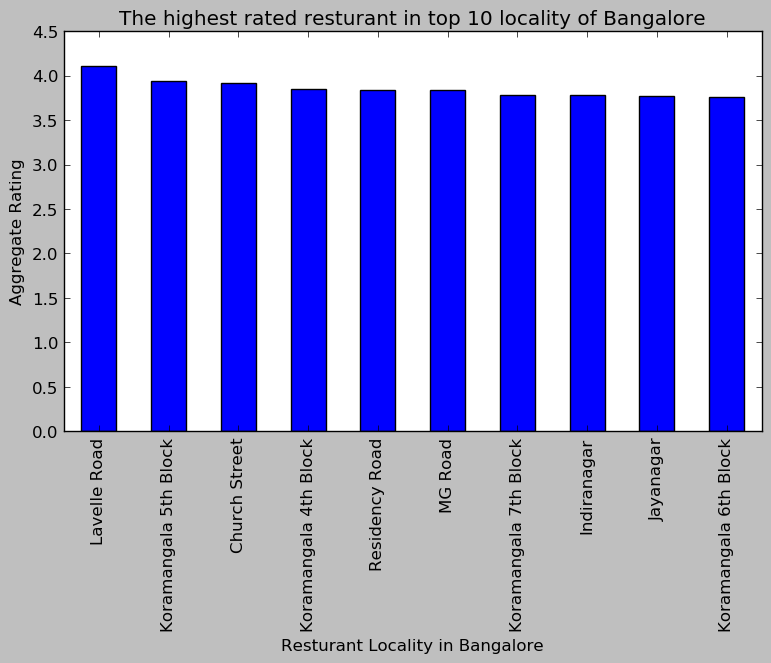

In [151]:
import matplotlib.pyplot as plt
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('The highest rated resturant in top 10 locality of Bangalore')
#On x-axis
final_df_two.groupby('location')['rate'].mean().nlargest(10).plot(kind='bar')
plt.xlabel('Resturant Locality in Bangalore')
#On y-axis
plt.ylabel('Aggregate Rating')
#displays the plot
plt.show()

## Create map to show restaurant clusters basis locations

In [152]:
address = 'Bangalore, City'
geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Bangalore City, are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Bangalore City, are 12.9791198, 77.5912997.


In [153]:
Bangalore_Rest = folium.Map(location=[12.98, 77.60], zoom_start=12)

In [155]:
Bangalore_Rest

In [156]:
X=final_df_two['latitude']
#print(X)

In [157]:
Y=final_df_two['longitude']
#print(Y)

In [158]:
Z = np.stack((X, Y), axis=1)
print(Z)

[[12.9152208 77.573598 ]
 [12.9152208 77.573598 ]
 [12.9152208 77.573598 ]
 ...
 [13.0288251 77.5711478]
 [13.0288251 77.5711478]
 [13.0288251 77.5711478]]


In [159]:
kmeans = KMeans(n_clusters=5, random_state=0).fit(Z)

clusters = kmeans.labels_
colors = ['red', 'green', 'blue', 'yellow','orange']
final_df_two ['Cluster'] = clusters

In [160]:


for latitude, longitude, Locality, cluster in zip(final_df_two['latitude'], final_df_two['longitude'], final_df_two['listed_in(city)'], final_df_two['Cluster']):
    label = folium.Popup(Locality, parse_html=True)
    folium.CircleMarker(
        [latitude, longitude],
        radius=5,
        popup=label,
        color='black',
        fill=True,
        fill_color=colors[cluster],
        fill_opacity=0.7).add_to(Bangalore_Rest)  


In [161]:
Bangalore_Rest 


## Calculate the maximum number of restaurants are of which type

In [162]:
final_df_three.head()

,name,online_order,book_table,location,approx_cost(for two people),listed_in(city),rest_type,latitude,longitude
0,Jalsa,Yes,Yes,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
1,Spice Elephant,Yes,No,Banashankari,800,Banashankari,Casual Dining,12.915221,77.573598
2,San Churro Cafe,Yes,No,Banashankari,800,Banashankari,"Cafe, Casual Dining",12.915221,77.573598
3,Addhuri Udupi Bhojana,No,No,Banashankari,300,Banashankari,Quick Bites,12.915221,77.573598
4,Onesta,Yes,Yes,Banashankari,600,Banashankari,"Casual Dining, Cafe",12.915221,77.573598


In [163]:
df_type=final_df_three.groupby('rest_type').count().reset_index()

In [164]:
df_type

,rest_type,name,online_order,book_table,location,approx_cost(for two people),listed_in(city),latitude,longitude
0,Bakery,557,557,557,557,557,557,557,557
1,"Bakery, Beverage Shop",4,4,4,4,4,4,4,4
2,"Bakery, Cafe",29,29,29,29,29,29,29,29
3,"Bakery, Dessert Parlor",65,65,65,65,65,65,65,65
4,"Bakery, Food Court",2,2,2,2,2,2,2,2
5,"Bakery, Kiosk",7,7,7,7,7,7,7,7
6,"Bakery, Quick Bites",110,110,110,110,110,110,110,110
7,"Bakery, Sweet Shop",3,3,3,3,3,3,3,3
8,Bar,179,179,179,179,179,179,179,179
9,"Bar, Cafe",5,5,5,5,5,5,5,5


In [165]:
df_type.sort_values(by=['name'],ascending=False)

,rest_type,name,online_order,book_table,location,approx_cost(for two people),listed_in(city),latitude,longitude
73,Quick Bites,9549,9549,9549,9549,9549,9549,9549,9549
25,Casual Dining,4885,4885,4885,4885,4885,4885,4885,4885
37,Delivery,1819,1819,1819,1819,1819,1819,1819,1819
86,"Takeaway, Delivery",1456,1456,1456,1456,1456,1456,1456,1456
18,Cafe,1314,1314,1314,1314,1314,1314,1314,1314
38,Dessert Parlor,1298,1298,1298,1298,1298,1298,1298,1298
14,Beverage Shop,593,593,593,593,593,593,593,593
0,Bakery,557,557,557,557,557,557,557,557
51,Food Court,388,388,388,388,388,388,388,388
26,"Casual Dining, Bar",339,339,339,339,339,339,339,339


## Maximum resturants are Quickbites, then Casual Dining. Desserts serving restaurants are more than Bars

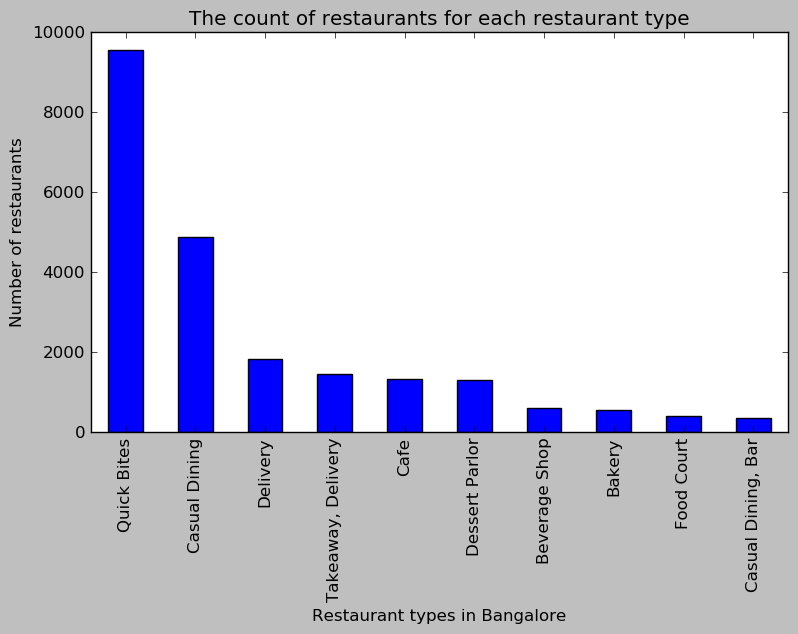

In [166]:
import matplotlib.pyplot as plt
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('The count of restaurants for each restaurant type')
#On x-axis
df_type.groupby('rest_type')['name'].mean().nlargest(10).plot(kind='bar')
plt.xlabel('Restaurant types in Bangalore')
#On y-axis
plt.ylabel('Number of restaurants')
#displays the plot
plt.show()

## Calculate the maximum number of restaurants are of which type in each location

In [167]:
df_locationwisetype=final_df_three.groupby(['location','rest_type']).count().reset_index()

In [168]:
df_locationwisetype.head()

,location,rest_type,name,online_order,book_table,approx_cost(for two people),listed_in(city),latitude,longitude
0,BTM,Bakery,52,52,52,52,52,52,52
1,BTM,"Bakery, Quick Bites",8,8,8,8,8,8,8
2,BTM,Bar,16,16,16,16,16,16,16
3,BTM,"Bar, Casual Dining",3,3,3,3,3,3,3
4,BTM,Beverage Shop,176,176,176,176,176,176,176


In [169]:
list_locations=df_locationwisetype['location'].unique().tolist()

In [170]:
df_maxlocationtype=[]
df_type_Res=[]
df_count_type=[]
for i in list_locations:
    df_maxlocationtype.append(df_locationwisetype[df_locationwisetype['name']==df_locationwisetype[df_locationwisetype['location']==i]['name'].max()]['location'].values[0])
    df_type_Res.append(df_locationwisetype[df_locationwisetype['name']==df_locationwisetype[df_locationwisetype['location']==i]['name'].max()]['rest_type'].values[0])
    df_count_type.append(df_locationwisetype[df_locationwisetype['name']==df_locationwisetype[df_locationwisetype['location']==i]['name'].max()]['name'].values[0])



In [171]:
df_count_venuewise=pd.DataFrame({'Location':df_maxlocationtype,'Type_Res':df_type_Res,'Count_Res':df_count_type})

### Maximum restaurants in HSR have delivery option and so does Kormangala 4th block

<Figure size 900x500 with 0 Axes>

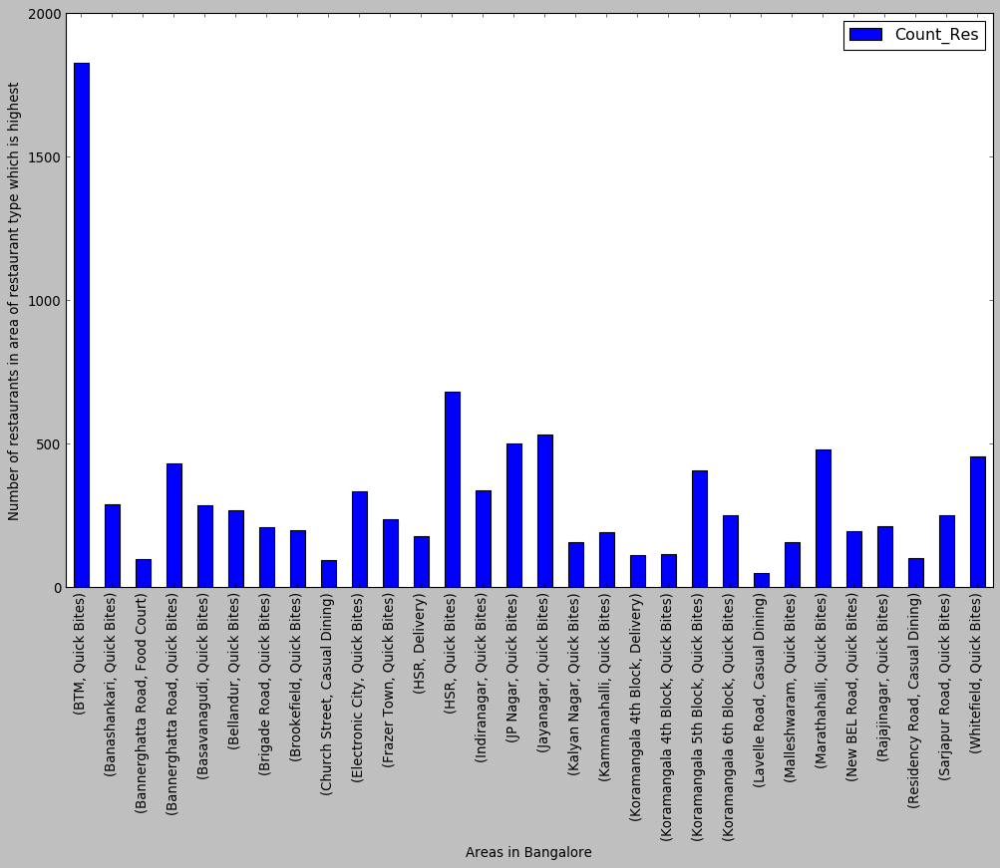

In [172]:
import matplotlib.pyplot as plt
plt.figure(figsize=(9,5), dpi = 100)
# title
#plt.title('Restaurant type of each location with maximum count ')
#On x-axis
#df_type.groupby('listed_in(type)')['rate'].mean().nlargest(10).plot(kind='bar')
df_count_venuewise.groupby(['Location','Type_Res']).mean().plot(kind='bar')
plt.xlabel('Areas in Bangalore')
#On y-axis
plt.ylabel('Number of restaurants in area of restaurant type which is highest')
#displays the plot
plt.show()

# Calculate the maximum and minimum number of restaurants are in which location

### Maximum restaurants are in BTM and min in Lavelle Road

In [173]:
df_locationwisetype.groupby('location')['name'].sum().sort_values()

location
Lavelle Road              268
Old Airport Road          282
Church Street             290
Rajajinagar               385
Residency Road            398
Brookefield               403
New BEL Road              407
Kammanahalli              420
Malleshwaram              441
Basavanagudi              485
MG Road                   488
Kalyan Nagar              492
Frazer Town               549
Banashankari              566
Koramangala 4th Block     601
Sarjapur Road             664
Koramangala 6th Block     670
Brigade Road              713
Electronic City           747
Koramangala 7th Block     750
Bellandur                 764
Bannerghatta Road        1063
Marathahalli             1182
Jayanagar                1302
Indiranagar              1324
Whitefield               1362
Koramangala 5th Block    1415
JP Nagar                 1462
HSR                      1877
BTM                      3571
Name: name, dtype: int64

## Get the neighbours for all the latitude and longitude using FourSquare API

In [174]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    LIMIT=100
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [175]:
df_coordinates.head()

,location,latitude,longitude
0,Banashankari,12.915221,77.573598
1,Bannerghatta Road,12.935802,77.601392
2,Basavanagudi,12.941726,77.575502
3,Bellandur,12.979120,77.591300
4,Brigade Road,12.973613,77.607472


In [176]:
# find the venues in all New Delhi Locality
Bangalore_venues = getNearbyVenues(names=df_coordinates['location'],
                                   latitudes=df_coordinates['latitude'],
                                   longitudes=df_coordinates['longitude']
                                  )

Banashankari
Bannerghatta Road
Basavanagudi
Bellandur
Brigade Road
Brookefield
BTM
Church Street
Electronic City
Frazer Town
HSR
Indiranagar
Jayanagar
JP Nagar
Kalyan Nagar
Kammanahalli
Koramangala 4th Block
Koramangala 5th Block
Koramangala 6th Block
Koramangala 7th Block
Lavelle Road
Malleshwaram
Marathahalli
MG Road
New BEL Road
Old Airport Road
Rajajinagar
Residency Road
Sarjapur Road
Whitefield


In [177]:
Bangalore_venues

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Banashankari,12.915221,77.573598,Shivaji Military Hotel,12.917919,77.573925,Indian Restaurant
1,Banashankari,12.915221,77.573598,Wine Baron,12.914515,77.572826,Liquor Store
2,Banashankari,12.915221,77.573598,Banashankari Metro Station,12.915297,77.573656,Metro Station
3,Banashankari,12.915221,77.573598,Total Fitness,12.917816,77.574609,Gym / Fitness Center
4,Banashankari,12.915221,77.573598,Cane Fresh,12.917894,77.575859,Juice Bar
5,Bannerghatta Road,12.935802,77.601392,Subway,12.931952,77.602658,Sandwich Place
6,Bannerghatta Road,12.935802,77.601392,Cafe Coffee Day,12.931664,77.601027,Coffee Shop
7,Bannerghatta Road,12.935802,77.601392,CCD @ Accenture,12.933075,77.601640,Café
8,Bannerghatta Road,12.935802,77.601392,"Accenture B3, Cafeteria",12.932386,77.602535,Building
9,Basavanagudi,12.941726,77.575502,Rogue Elephant,12.941541,77.577234,Restaurant


In [178]:
# one hot encoding
venues_type_onehot = pd.get_dummies(Bangalore_venues[['Venue Category']], prefix="", prefix_sep="")

# add the neighborhood column
venues_type_onehot['Neighborhood'] = Bangalore_venues['Neighborhood']
fix_columns = list(venues_type_onehot.columns[-1:]) + list(venues_type_onehot.columns[:-1])
venues_type_onehot = venues_type_onehot[fix_columns]

print(venues_type_onehot.shape)
venues_type_onehot.head()

(616, 130)


,Neighborhood,American Restaurant,Andhra Restaurant,Art Gallery,Arts & Crafts Store,Asian Restaurant,BBQ Joint,Bakery,Bar,Beer Garden,Bike Shop,Bistro,Boarding House,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Cafeteria,Café,Camera Store,Candy Store,Capitol Building,Chettinad Restaurant,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,Convenience Store,Cosmetics Shop,Cricket Ground,Cupcake Shop,Deli / Bodega,Department Store,Dessert Shop,Diner,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Farmers Market,Fast Food Restaurant,Financial or Legal Service,Flea Market,Food,Food Court,Food Truck,Fried Chicken Joint,Furniture / Home Store,Gastropub,General Entertainment,German Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hookah Bar,Hotel,Hotel Bar,Hyderabadi Restaurant,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Juice Bar,Karnataka Restaurant,Kerala Restaurant,Korean Restaurant,Lake,Liquor Store,Lounge,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motorcycle Shop,Movie Theater,Multicuisine Indian Restaurant,Museum,Music Store,Music Venue,North Indian Restaurant,Optical Shop,Other Nightlife,Paella Restaurant,Pakistani Restaurant,Park,Pharmacy,Pizza Place,Plaza,Pub,Punjabi Restaurant,Rajasthani Restaurant,Restaurant,Road,Salon / Barbershop,Sandwich Place,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Snack Place,South Indian Restaurant,Spa,Sports Bar,Steakhouse,Supermarket,Taco Place,Tea Room,Tex-Mex Restaurant,Thai Restaurant,Tibetan Restaurant,Toy / Game Store,Trail,Udupi Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Vineyard,Women's Store
0,Banashankari,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Banashankari,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,Banashankari,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,Banashankari,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,Banashankari,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [179]:
# get the common occurrence average of each venue type in each neighborhood
venue_count_df = venues_type_onehot.groupby(['Neighborhood']).mean().reset_index()

print(venue_count_df.shape)
venue_count_df.head()

(27, 130)


,Neighborhood,American Restaurant,Andhra Restaurant,Art Gallery,Arts & Crafts Store,Asian Restaurant,BBQ Joint,Bakery,Bar,Beer Garden,Bike Shop,Bistro,Boarding House,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Cafeteria,Café,Camera Store,Candy Store,Capitol Building,Chettinad Restaurant,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,Convenience Store,Cosmetics Shop,Cricket Ground,Cupcake Shop,Deli / Bodega,Department Store,Dessert Shop,Diner,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Farmers Market,Fast Food Restaurant,Financial or Legal Service,Flea Market,Food,Food Court,Food Truck,Fried Chicken Joint,Furniture / Home Store,Gastropub,General Entertainment,German Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hookah Bar,Hotel,Hotel Bar,Hyderabadi Restaurant,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Juice Bar,Karnataka Restaurant,Kerala Restaurant,Korean Restaurant,Lake,Liquor Store,Lounge,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motorcycle Shop,Movie Theater,Multicuisine Indian Restaurant,Museum,Music Store,Music Venue,North Indian Restaurant,Optical Shop,Other Nightlife,Paella Restaurant,Pakistani Restaurant,Park,Pharmacy,Pizza Place,Plaza,Pub,Punjabi Restaurant,Rajasthani Restaurant,Restaurant,Road,Salon / Barbershop,Sandwich Place,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Snack Place,South Indian Restaurant,Spa,Sports Bar,Steakhouse,Supermarket,Taco Place,Tea Room,Tex-Mex Restaurant,Thai Restaurant,Tibetan Restaurant,Toy / Game Store,Trail,Udupi Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Vineyard,Women's Store
0,BTM,0.0,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.125000,0.0,0.0,0.00,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.00,0.0,0.0,0.0625,0.0,0.062500,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.062500,0.000000,0.0,0.00,0.0,0.0,0.0625,0.0,0.125,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.00,0.0
1,Banashankari,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.200000,0.000000,0.00,0.0,0.0,0.0000,0.0,0.200000,0.0,0.0,0.2,0.0,0.0,0.0,0.0,0.2,0.0,0.000000,0.200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.00,0.0,0.0,0.0000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.00,0.0
2,Bannerghatta Road,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.0,0.00,0.0,0.0000,0.0,0.0,0.0,0.2500,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.00,0.0,0.0,0.0000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.25,0.0,0.0,0.0000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.00,0.0
3,Basavanagudi,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.090909,0.0,0.0,0.00,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0

In [180]:
## print each Locality along with the top 5 most common venues

num_top_venues = 5

for hood in venue_count_df['Neighborhood']:
    print("----"+hood+"----")
    temp = venue_count_df[venue_count_df['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----BTM----
            venue  freq
0     Snack Place  0.12
1            Café  0.12
2     Coffee Shop  0.06
3  Ice Cream Shop  0.06
4      Food Truck  0.06


----Banashankari----
                  venue  freq
0     Indian Restaurant   0.2
1  Gym / Fitness Center   0.2
2         Metro Station   0.2
3             Juice Bar   0.2
4          Liquor Store   0.2


----Bannerghatta Road----
            venue  freq
0     Coffee Shop  0.25
1  Sandwich Place  0.25
2            Café  0.25
3        Building  0.25
4     Music Store  0.00


----Basavanagudi----
                  venue  freq
0     Indian Restaurant  0.27
1            Restaurant  0.09
2            Hookah Bar  0.09
3  Gym / Fitness Center  0.09
4         Metro Station  0.09


----Bellandur----
                 venue  freq
0             Vineyard  0.25
1                Hotel  0.25
2                 Park  0.25
3     Capitol Building  0.25
4  American Restaurant  0.00


----Brigade Road----
               venue  freq
0  Indian Restaurant  

In [181]:
## put that into a pandas dataframe
## First, write a function to sort the venues in descending order.

def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [182]:
## create the new dataframe and display the top 10 venues for each Locality.

num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
Locality_venues_sorted = pd.DataFrame(columns=columns)
Locality_venues_sorted['Neighborhood'] = venue_count_df['Neighborhood']

for ind in np.arange(venue_count_df.shape[0]):
    Locality_venues_sorted.iloc[ind, 1:] = return_most_common_venues(venue_count_df.iloc[ind, :], num_top_venues)

Locality_venues_sorted

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,BTM,Snack Place,Café,Food Truck,Indian Restaurant,Restaurant,Shopping Mall,Fast Food Restaurant,Department Store,Dumpling Restaurant,Bakery
1,Banashankari,Juice Bar,Metro Station,Gym / Fitness Center,Liquor Store,Indian Restaurant,Department Store,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop
2,Bannerghatta Road,Coffee Shop,Building,Sandwich Place,Café,Women's Store,Dessert Shop,Dumpling Restaurant,Donut Shop,Diner,Deli / Bodega
3,Basavanagudi,Indian Restaurant,Gym / Fitness Center,Road,Restaurant,Metro Station,Café,Tea Room,Hookah Bar,Mediterranean Restaurant,Cupcake Shop
4,Bellandur,Hotel,Vineyard,Park,Capitol Building,Deli / Bodega,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store
5,Brigade Road,Indian Restaurant,Café,Pub,Bar,Lounge,Chinese Restaurant,Coffee Shop,Donut Shop,Pizza Place,Hotel
6,Brookefield,Indian Restaurant,Bakery,Fast Food Restaurant,Department Store,Salon / Barbershop,Breakfast Spot,Dessert Shop,Burger Joint,Asian Restaurant,Ice Cream Shop
7,Church Street,Indian Restaurant,Fast Food Restaurant,Food Truck,Grocery Store,Italian Restaurant,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store
8,Electronic City,Hotel,Vineyard,Park,Capitol Building,Deli / Bodega,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store
9,Frazer Town,Indian Restaurant,Middle Eastern Restaurant,Ice Cream Shop,Pizza Place,Bakery,Fast Food Restaurant,Tea Room,Snack Place,BBQ Joint,Chinese Restaurant


## Cluster Locality
## Run k-means to cluster the Locality into 5 clusters according to venue types

In [183]:
# set number of clusters
kclusters = 5

Bangalore_clustering = venue_count_df.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(Bangalore_clustering)

# check cluster labels generated for each row in the dataframe
labels = kmeans.labels_

In [184]:
venue_count_df["Clus_km"] = labels

In [185]:
venue_count_df.head()

,Neighborhood,American Restaurant,Andhra Restaurant,Art Gallery,Arts & Crafts Store,Asian Restaurant,BBQ Joint,Bakery,Bar,Beer Garden,Bike Shop,Bistro,Boarding House,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Cafeteria,Café,Camera Store,Candy Store,Capitol Building,Chettinad Restaurant,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,Convenience Store,Cosmetics Shop,Cricket Ground,Cupcake Shop,Deli / Bodega,Department Store,Dessert Shop,Diner,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Farmers Market,Fast Food Restaurant,Financial or Legal Service,Flea Market,Food,Food Court,Food Truck,Fried Chicken Joint,Furniture / Home Store,Gastropub,General Entertainment,German Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hookah Bar,Hotel,Hotel Bar,Hyderabadi Restaurant,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Juice Bar,Karnataka Restaurant,Kerala Restaurant,Korean Restaurant,Lake,Liquor Store,Lounge,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motorcycle Shop,Movie Theater,Multicuisine Indian Restaurant,Museum,Music Store,Music Venue,North Indian Restaurant,Optical Shop,Other Nightlife,Paella Restaurant,Pakistani Restaurant,Park,Pharmacy,Pizza Place,Plaza,Pub,Punjabi Restaurant,Rajasthani Restaurant,Restaurant,Road,Salon / Barbershop,Sandwich Place,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Snack Place,South Indian Restaurant,Spa,Sports Bar,Steakhouse,Supermarket,Taco Place,Tea Room,Tex-Mex Restaurant,Thai Restaurant,Tibetan Restaurant,Toy / Game Store,Trail,Udupi Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Vineyard,Women's Store,Clus_km
0,BTM,0.0,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.125000,0.0,0.0,0.00,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.00,0.0,0.0,0.0625,0.0,0.062500,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.062500,0.000000,0.0,0.00,0.0,0.0,0.0625,0.0,0.125,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.00,0.0,0
1,Banashankari,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.200000,0.000000,0.00,0.0,0.0,0.0000,0.0,0.200000,0.0,0.0,0.2,0.0,0.0,0.0,0.0,0.2,0.0,0.000000,0.200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.00,0.0,0.0,0.0000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.00,0.0,0
2,Bannerghatta Road,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.0,0.00,0.0,0.0000,0.0,0.0,0.0,0.2500,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.00,0.0,0.0,0.0000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.25,0.0,0.0,0.0000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.00,0.0,1
3,Basavanagudi,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.090909,0.0,0.0,0.00,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.

In [186]:
venue_clusters=venue_count_df.merge(df_coordinates,left_on='Neighborhood',right_on='location')

In [187]:
venue_clusters.head()

,Neighborhood,American Restaurant,Andhra Restaurant,Art Gallery,Arts & Crafts Store,Asian Restaurant,BBQ Joint,Bakery,Bar,Beer Garden,Bike Shop,Bistro,Boarding House,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Cafeteria,Café,Camera Store,Candy Store,Capitol Building,Chettinad Restaurant,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,Convenience Store,Cosmetics Shop,Cricket Ground,Cupcake Shop,Deli / Bodega,Department Store,Dessert Shop,Diner,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Farmers Market,Fast Food Restaurant,Financial or Legal Service,Flea Market,Food,Food Court,Food Truck,Fried Chicken Joint,Furniture / Home Store,Gastropub,General Entertainment,German Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hookah Bar,Hotel,Hotel Bar,Hyderabadi Restaurant,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Juice Bar,Karnataka Restaurant,Kerala Restaurant,Korean Restaurant,Lake,Liquor Store,Lounge,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Motorcycle Shop,Movie Theater,Multicuisine Indian Restaurant,Museum,Music Store,Music Venue,North Indian Restaurant,Optical Shop,Other Nightlife,Paella Restaurant,Pakistani Restaurant,Park,Pharmacy,Pizza Place,Plaza,Pub,Punjabi Restaurant,Rajasthani Restaurant,Restaurant,Road,Salon / Barbershop,Sandwich Place,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Snack Place,South Indian Restaurant,Spa,Sports Bar,Steakhouse,Supermarket,Taco Place,Tea Room,Tex-Mex Restaurant,Thai Restaurant,Tibetan Restaurant,Toy / Game Store,Trail,Udupi Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Vineyard,Women's Store,Clus_km,location,latitude,longitude
0,BTM,0.0,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.125000,0.0,0.0,0.00,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.00,0.0,0.0,0.0625,0.0,0.062500,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.062500,0.000000,0.0,0.00,0.0,0.0,0.0625,0.0,0.125,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0625,0.0,0.00,0.0,0,BTM,12.911276,77.604565
1,Banashankari,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.200000,0.000000,0.00,0.0,0.0,0.0000,0.0,0.200000,0.0,0.0,0.2,0.0,0.0,0.0,0.0,0.2,0.0,0.000000,0.200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.00,0.0,0.0,0.0000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.00,0.0,0,Banashankari,12.915221,77.573598
2,Bannerghatta Road,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.0,0.00,0.0,0.0000,0.0,0.0,0.0,0.2500,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.00,0.0,0.0,0.0000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.25,0.0,0.0,0.0000,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.00,0.0,1,Bannerghatta Road,12.935802,77.601392
3,Basavanagudi,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.090909

In [188]:
Locality_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,BTM,Snack Place,Café,Food Truck,Indian Restaurant,Restaurant,Shopping Mall,Fast Food Restaurant,Department Store,Dumpling Restaurant,Bakery
1,Banashankari,Juice Bar,Metro Station,Gym / Fitness Center,Liquor Store,Indian Restaurant,Department Store,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop
2,Bannerghatta Road,Coffee Shop,Building,Sandwich Place,Café,Women's Store,Dessert Shop,Dumpling Restaurant,Donut Shop,Diner,Deli / Bodega
3,Basavanagudi,Indian Restaurant,Gym / Fitness Center,Road,Restaurant,Metro Station,Café,Tea Room,Hookah Bar,Mediterranean Restaurant,Cupcake Shop
4,Bellandur,Hotel,Vineyard,Park,Capitol Building,Deli / Bodega,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store


In [189]:
venue_clustered=venue_clusters[['Neighborhood','Clus_km','location','latitude','longitude']]

In [190]:
cluster_tovisualize=venue_clustered.merge(Locality_venues_sorted,left_on='Neighborhood',right_on='Neighborhood')

In [191]:
cluster_tovisualize.head()

,Neighborhood,Clus_km,location,latitude,longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,BTM,0,BTM,12.911276,77.604565,Snack Place,Café,Food Truck,Indian Restaurant,Restaurant,Shopping Mall,Fast Food Restaurant,Department Store,Dumpling Restaurant,Bakery
1,Banashankari,0,Banashankari,12.915221,77.573598,Juice Bar,Metro Station,Gym / Fitness Center,Liquor Store,Indian Restaurant,Department Store,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop
2,Bannerghatta Road,1,Bannerghatta Road,12.935802,77.601392,Coffee Shop,Building,Sandwich Place,Café,Women's Store,Dessert Shop,Dumpling Restaurant,Donut Shop,Diner,Deli / Bodega
3,Basavanagudi,0,Basavanagudi,12.941726,77.575502,Indian Restaurant,Gym / Fitness Center,Road,Restaurant,Metro Station,Café,Tea Room,Hookah Bar,Mediterranean Restaurant,Cupcake Shop
4,Bellandur,4,Bellandur,12.979120,77.591300,Hotel,Vineyard,Park,Capitol Building,Deli / Bodega,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store


In [211]:
import matplotlib 
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [matplotlib.colors.rgb2hex(i) for i in colors_array]
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(cluster_tovisualize['latitude'], cluster_tovisualize['longitude'], cluster_tovisualize['Neighborhood'], cluster_tovisualize['Clus_km']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters


### Examine clusters

In [212]:
cluster_tovisualize.head()

,Neighborhood,Clus_km,location,latitude,longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,BTM,0,BTM,12.911276,77.604565,Snack Place,Café,Food Truck,Indian Restaurant,Restaurant,Shopping Mall,Fast Food Restaurant,Department Store,Dumpling Restaurant,Bakery
1,Banashankari,0,Banashankari,12.915221,77.573598,Juice Bar,Metro Station,Gym / Fitness Center,Liquor Store,Indian Restaurant,Department Store,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop
2,Bannerghatta Road,1,Bannerghatta Road,12.935802,77.601392,Coffee Shop,Building,Sandwich Place,Café,Women's Store,Dessert Shop,Dumpling Restaurant,Donut Shop,Diner,Deli / Bodega
3,Basavanagudi,0,Basavanagudi,12.941726,77.575502,Indian Restaurant,Gym / Fitness Center,Road,Restaurant,Metro Station,Café,Tea Room,Hookah Bar,Mediterranean Restaurant,Cupcake Shop
4,Bellandur,4,Bellandur,12.979120,77.591300,Hotel,Vineyard,Park,Capitol Building,Deli / Bodega,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store


### Cluster 0

### Indian Restuarants and Gym/fitness centres are the most recommended venues near these locations

In [213]:
cluster_tovisualize[cluster_tovisualize['Clus_km']==0]['Neighborhood'].unique()

array(['BTM', 'Banashankari', 'Basavanagudi', 'Brigade Road',
       'Brookefield', 'Church Street', 'Frazer Town', 'HSR',
       'Indiranagar', 'JP Nagar', 'Jayanagar', 'Kalyan Nagar',
       'Koramangala 4th Block', 'Lavelle Road', 'MG Road', 'Malleshwaram',
       'Marathahalli', 'New BEL Road', 'Old Airport Road',
       'Residency Road', 'Sarjapur Road'], dtype=object)

In [214]:
cluster_tovisualize.loc[cluster_tovisualize['Clus_km'] == 0, cluster_tovisualize.columns[[1] + list(range(5, cluster_tovisualize.shape[1]))]]




,Clus_km,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,0,Snack Place,Café,Food Truck,Indian Restaurant,Restaurant,Shopping Mall,Fast Food Restaurant,Department Store,Dumpling Restaurant,Bakery
1,0,Juice Bar,Metro Station,Gym / Fitness Center,Liquor Store,Indian Restaurant,Department Store,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop
3,0,Indian Restaurant,Gym / Fitness Center,Road,Restaurant,Metro Station,Café,Tea Room,Hookah Bar,Mediterranean Restaurant,Cupcake Shop
5,0,Indian Restaurant,Café,Pub,Bar,Lounge,Chinese Restaurant,Coffee Shop,Donut Shop,Pizza Place,Hotel
6,0,Indian Restaurant,Bakery,Fast Food Restaurant,Department Store,Salon / Barbershop,Breakfast Spot,Dessert Shop,Burger Joint,Asian Restaurant,Ice Cream Shop
7,0,Indian Restaurant,Fast Food Restaurant,Food Truck,Grocery Store,Italian Restaurant,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store
9,0,Indian Restaurant,Middle Eastern Restaurant,Ice Cream Shop,Pizza Place,Bakery,Fast Food Restaurant,Tea Room,Snack Place,BBQ Joint,Chinese Restaurant
10,0,Indian Restaurant,Café,Farmers Market,Snack Place,South Indian Restaurant,Ice Cream Shop,General Entertainment,Burger Joint,Punjabi Restaurant,Pub
11,0,Pub,Lounge,Bakery,Restaurant,Café,Italian Restaurant,Indian Restaurant,Cupcake Shop,Cocktail Bar,Tex-Mex Restaurant
12,0,Brewery,Pizza Place,Bus Station,Bus Stop,Boarding House,Bakery,Department Store,Indian Restaurant,Fast Food Restaurant,Deli / Bodega


### Cluster 1

### Diners are the most recommended venues near these locations

In [215]:
cluster_tovisualize[cluster_tovisualize['Clus_km']==1]['Neighborhood'].unique()

array(['Bannerghatta Road', 'Whitefield'], dtype=object)

In [216]:
cluster_tovisualize.loc[cluster_tovisualize['Clus_km'] == 1, cluster_tovisualize.columns[[1] + list(range(5, cluster_tovisualize.shape[1]))]]

,Clus_km,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,1,Coffee Shop,Building,Sandwich Place,Café,Women's Store,Dessert Shop,Dumpling Restaurant,Donut Shop,Diner,Deli / Bodega
26,1,Café,Hotel Bar,Bakery,Kerala Restaurant,Eastern European Restaurant,Hotel,Gym / Fitness Center,Cosmetics Shop,Cricket Ground,Convenience Store


### Cluster 2

### Cafes are the most recommended venues near these locations

In [217]:
cluster_tovisualize[cluster_tovisualize['Clus_km']==2]['Neighborhood'].unique()

array(['Rajajinagar'], dtype=object)

In [218]:
cluster_tovisualize.loc[cluster_tovisualize['Clus_km'] == 2, cluster_tovisualize.columns[[1] + list(range(5, cluster_tovisualize.shape[1]))]]

,Clus_km,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
23,2,Breakfast Spot,Arts & Crafts Store,Bakery,Motorcycle Shop,Women's Store,Dessert Shop,Eastern European Restaurant,Dumpling Restaurant,Donut Shop,Diner


### Cluster 3

### Sports Bar are the most recommended venues near these locations

In [219]:
cluster_tovisualize[cluster_tovisualize['Clus_km']==3]['Neighborhood'].unique()

array(['Kammanahalli'], dtype=object)

In [220]:
cluster_tovisualize.loc[cluster_tovisualize['Clus_km'] == 3, cluster_tovisualize.columns[[1] + list(range(5, cluster_tovisualize.shape[1]))]]

,Clus_km,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
15,3,Bar,Lake,Department Store,Eastern European Restaurant,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Women's Store,Farmers Market


### Cluster 4

### Indian Restuarants and Cafes are the most recommended venues near these locations

In [221]:
cluster_tovisualize[cluster_tovisualize['Clus_km']==4]['Neighborhood'].unique()

array(['Bellandur', 'Electronic City'], dtype=object)

In [222]:
cluster_tovisualize.loc[cluster_tovisualize['Clus_km'] == 4, cluster_tovisualize.columns[[1] + list(range(5, cluster_tovisualize.shape[1]))]]

,Clus_km,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
4,4,Hotel,Vineyard,Park,Capitol Building,Deli / Bodega,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store
8,4,Hotel,Vineyard,Park,Capitol Building,Deli / Bodega,Dumpling Restaurant,Donut Shop,Diner,Dessert Shop,Department Store


## Results and Discussion <a name="results"></a>

Our analysis shows that there are huge number of restaurants in Bangalore and food culture is very prominent across different locations/neighbourhoods of Bangalore. Analysing the **online ordering option** availabilty for restaurants across Bangalore, we realised that there are **48%** restaurants which have online delivery available through Zomato. Next, we decided to seek a relationship between the availability of **delivery option and rating** of the restaurant. It was observed that the restaurant with online delivery option is likely to get a higher user rating.
Next, analysing the **booking table option** through Zomato app, we found that **9.2%** out of total have a booking option available.Further, there is a **positive correlation** between the booking option and the restaurant rating. This insight can be utilised by the restaurant owners that if they keep the booking table option on the app, they will get better ratings due to **better customer experience** with reduced waiting time.
Next, we analysed the restaurant chains with **maximum venues** across Bangalore. Out of which **Cafe Coffee Day** had close to **60 venues** across the city being the highest, followed by **Baskin Robbins**. This insight can be utilised by people who want to invest and open a currently established food chain and see the popularity.
Next, cost for two people was analysed across the restaurants. **The Leela Palace** was the costliest with cost of  around **6000 Rupees** for two people followed by **Raddison Blue** with 5500 and **JW Marriott** with 4000 cost.
Cheapest were analysed with the lowest being **Bread and Better** and **Funky Food**.
Next, analysis was done to identify neighbourhoods with the highest rated restaurants in the city. **Lavelle Road**
topped the list having highest rated restaurants in Bangalore and can be a go-to option for foodies to explore the highest rated restaurants.
Next, analysis was done to identify the **restaurant type** which is most popular across Bangalore. **Quick Bites** type of restaurants were most in number, followed by **casual dining**. Also **Desert serving places** were more than **bars** across the city.
Next, analysis was done for all neighbourhooods to identify the **most popular restaurant type in each area**.
It was found out that **HSR and Kormangala** have maximum **delivery** options available compared to other restaurants in the area. This is a useful insight for foodies for them to decide their living place basis the popularity of restaurant types available nearby.
Also, we found out the places with the **maximum restaurants in the city** which was **BTM**. This is expected as BTM is majorly occupied by bachelors and hence the largest number of eating joints. On the other hand, **minimum restaurants in city** were in **Lavelle Road**.
After this, the city was divided into clusters basis the nearby venues in the locality/neighbourhood through k-means clustering. We found that there were similar neighbourhoods which could be clustered together basis the nearby venues. The result was that the city was divided into five clusters.**Indian Restaurants and Gym/fitness centres** were the most common venues near the **Cluster 1** which were the  similar locations like Brigade Road, M.G Road.
Similarly, insights were drawn for **Cluster 2** where **Diners** were the most common, **Cluster 3** where **Cafes** were recommended ,**Cluster 4** where Sports Bar are popular and **Cluster 5** with **Cafes and Indian Restaurants** in areas like Marathahalli and HSR.

## Conclusion <a name="conclusion"></a>

Purpose of this project was to analyse the restaurants in different neighbourhoods across the city. This analysis is useful for foodies to decide the places they can visit basis their budget and preferences, locations where there are highest rated restaurants, locations with popular online delivery options and so on. The relationship between online ordering and book table options on Zomato app with the restaurant ratings was identified and can be utilised by restaurant owners for better customer experience. The clustering exercise done in the project is useful for the foodies who are living or shifting to Bangalore to decide the neighbourhoods to explore and also to the stakeholders who want to open a new restaurant chain or invest in an established food chain basis their popularity.